Question: Are delays independent to time of day, or day of week?

Developer: TANMOY DAS <br>
Date: May 15, 2022


Outline of this Python Notebook:
1. Data Exploration
2. Premodeling (Feature Engineering)
3. Time Series Analysis

# Data Exploration

## Data Importing & Preprocessing

In [5]:
# import necessarry Python libraries
import pandas as pd
import datetime
import matplotlib.pyplot as plt
import datetime

import matplotlib.pyplot as plt
import matplotlib
from matplotlib.pyplot import figure
import plotly.express as px

In [6]:
# import data from 2020 - 2022
data2020_2022 = pd.read_excel('Data/SE - Terminal Wait Times 2020_2022.xlsx', sheet_name='20202022').copy() 

In [7]:
#data2020_2022 = data2020_2022_r.get('20202022')
data2020_2022.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 275105 entries, 0 to 275104
Data columns (total 6 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   Transponder       275105 non-null  int64         
 1   LocationIn        275105 non-null  object        
 2   LocationOut       275105 non-null  object        
 3   TimeIn            275105 non-null  datetime64[ns]
 4   TimeOut           275105 non-null  datetime64[ns]
 5   Difference (min)  275105 non-null  int64         
dtypes: datetime64[ns](2), int64(2), object(2)
memory usage: 12.6+ MB


In [8]:
# Convert datetime to date
data2020_2022['Date'] = pd.to_datetime(data2020_2022['TimeIn']).dt.date 

# Create DAY column
days = ['Mon','Tues','Wed','Thurs','Fri','Sat','Sun']
weekday = []
for i in data2020_2022['Date']:
    weekday.append(days[i.weekday()])
   # print(i)
data2020_2022['Weekday'] = weekday

# Create MONTH column
data2020_2022['Month'] = [i.strftime("%B") for i in data2020_2022['Date']]

# Rename column to "Delay"
data2020_2022.rename(columns = {'Difference (min)':'Delay'}, inplace = True)



In [9]:
# Create HOUR column
hours = ['07:00-07:59','08:00-08:59','09:00-09:59','10:00-10:59','11:00-11:59','12:00-12:59','13:00-13:59', 
        '14:00-14:59', '15:00-15:59', '16:00-16:59', '17:00-17:59', '18:00-18:59', '19:00-20:00']
Hours = []
for i in data2020_2022['TimeIn']:
    if (i.time() > datetime.time(7, 0, 0) and i.time() < datetime.time(8, 0, 0) ):
        Hours.append('07:00-07:59') 
    elif(i.time() >= datetime.time(8, 0, 0) and i.time() < datetime.time(9, 0, 0) ):
        Hours.append('08:00-08:59')
    elif(i.time() >= datetime.time(9, 0, 0) and i.time() < datetime.time(10, 0, 0) ):
        Hours.append('09:00-09:59')
    elif(i.time() >= datetime.time(10, 0, 0) and i.time() < datetime.time(11, 0, 0) ):
        Hours.append('10:00-10:59')
    elif(i.time() >= datetime.time(11, 0, 0) and i.time() < datetime.time(12, 0, 0) ):
        Hours.append('11:00-11:59')
    elif(i.time() >= datetime.time(12, 0, 0) and i.time() < datetime.time(13, 0, 0) ):
        Hours.append('12:00-12:59')
    elif(i.time() >= datetime.time(13, 0, 0) and i.time() < datetime.time(14, 0, 0) ):
        Hours.append('13:00-13:59')
    elif(i.time() >= datetime.time(14, 0, 0) and i.time() < datetime.time(15, 0, 0) ):
        Hours.append('14:00-14:59')
    elif(i.time() >= datetime.time(15, 0, 0) and i.time() < datetime.time(16, 0, 0) ):
        Hours.append('15:00-15:59')
    elif(i.time() >= datetime.time(16, 0, 0) and i.time() < datetime.time(17, 0, 0) ):
        Hours.append('16:00-16:59')
    elif(i.time() >= datetime.time(17, 0, 0) and i.time() < datetime.time(18, 0, 0) ):
        Hours.append('17:00-17:59')
    elif(i.time() >= datetime.time(18, 0, 0) and i.time() < datetime.time(19, 0, 0) ):
        Hours.append('18:00-18:59')
    else:
        Hours.append('19:00-20:00')
data2020_2022['Hours'] = Hours

In [10]:
data2020_2022

,Transponder,LocationIn,LocationOut,TimeIn,TimeOut,Delay,Date,Weekday,Month,Hours
0,17022,2(A),2(En),2020-01-02 08:56:49,2020-01-02 10:51:46,0,2020-01-02,Thurs,January,08:00-08:59
1,8230,2(A),2(En),2020-01-02 10:17:40,2020-01-02 11:01:05,1,2020-01-02,Thurs,January,10:00-10:59
2,8212,2(A),2(En),2020-01-02 09:17:53,2020-01-02 11:22:03,22,2020-01-02,Thurs,January,09:00-09:59
3,8248,2(A),2(En),2020-01-02 10:38:28,2020-01-02 11:22:14,22,2020-01-02,Thurs,January,10:00-10:59
4,8433,2(A),2(En),2020-01-02 09:47:12,2020-01-02 11:22:42,23,2020-01-02,Thurs,January,09:00-09:59
...,...,...,...,...,...,...,...,...,...,...
275100,58660,2(En),2(Ex),2022-03-31 19:12:26,2022-03-31 19:36:49,24,2022-03-31,Thurs,March,19:00-20:00
275101,58660,2(A),2(Ex),2022-03-31 19:03:53,2022-03-31 19:36:49,33,2022-03-31,Thurs,March,19:00-20:00
275102,8160,2(A),2(Ex),2022-03-31 19:08:27,2022-03-31 19:38:26,30,2022-03-31,Thurs,March,19:00-20:00
275103,8456,2(En),2(Ex),2022-03-31 19:27:31,2022-03-31 19:43:26,16,2022-03-31,Thurs,March,19:00-20:00


In [11]:
display(data2020_2022.groupby(['Weekday']).sum())

display(data2020_2022.groupby(['Weekday']).mean())


,Transponder,Delay
Weekday,,
Fri,1221798599,2721568
Mon,966170026,2219878
Sat,8708970,12146
Sun,1630052,2845
Thurs,1110577024,2276635
Tues,1066654471,2302737
Wed,1081086985,2273984


,Transponder,Delay
Weekday,,
Fri,19851.795389,44.220063
Mon,19797.349056,45.486507
Sat,22160.229008,30.905852
Sun,19878.682927,34.695122
Thurs,19958.612321,40.914294
Tues,19605.816947,42.325834
Wed,19934.484898,41.930668


In [12]:
display(data2020_2022.groupby(['Hours']).sum())

#display(data2022.groupby(['Hours']).mean())


,Transponder,Delay
Hours,,
07:00-07:59,1186222,4331
08:00-08:59,7081194,21245
09:00-09:59,66496322,236792
10:00-10:59,303456841,925506
11:00-11:59,509547690,1108911
12:00-12:59,602458056,1086624
13:00-13:59,650084397,1117104
14:00-14:59,611984002,1427621
15:00-15:59,483937120,1545468


## Trend of DELAY over the years

In [13]:
data2020_2022

,Transponder,LocationIn,LocationOut,TimeIn,TimeOut,Delay,Date,Weekday,Month,Hours
0,17022,2(A),2(En),2020-01-02 08:56:49,2020-01-02 10:51:46,0,2020-01-02,Thurs,January,08:00-08:59
1,8230,2(A),2(En),2020-01-02 10:17:40,2020-01-02 11:01:05,1,2020-01-02,Thurs,January,10:00-10:59
2,8212,2(A),2(En),2020-01-02 09:17:53,2020-01-02 11:22:03,22,2020-01-02,Thurs,January,09:00-09:59
3,8248,2(A),2(En),2020-01-02 10:38:28,2020-01-02 11:22:14,22,2020-01-02,Thurs,January,10:00-10:59
4,8433,2(A),2(En),2020-01-02 09:47:12,2020-01-02 11:22:42,23,2020-01-02,Thurs,January,09:00-09:59
...,...,...,...,...,...,...,...,...,...,...
275100,58660,2(En),2(Ex),2022-03-31 19:12:26,2022-03-31 19:36:49,24,2022-03-31,Thurs,March,19:00-20:00
275101,58660,2(A),2(Ex),2022-03-31 19:03:53,2022-03-31 19:36:49,33,2022-03-31,Thurs,March,19:00-20:00
275102,8160,2(A),2(Ex),2022-03-31 19:08:27,2022-03-31 19:38:26,30,2022-03-31,Thurs,March,19:00-20:00
275103,8456,2(En),2(Ex),2022-03-31 19:27:31,2022-03-31 19:43:26,16,2022-03-31,Thurs,March,19:00-20:00


In [14]:
data2020_2022_groupbyDate = data2020_2022.groupby(['Date','Month','Weekday']).sum().reset_index()
data2020_2022_groupbyDate
# this Delay is delay of all truck in certain date 



,Date,Month,Weekday,Transponder,Delay
0,2020-01-02,January,Thurs,2766061,2372
1,2020-01-03,January,Fri,2522163,1640
2,2020-01-06,January,Mon,2750628,3192
3,2020-01-07,January,Tues,3045710,2447
4,2020-01-08,January,Wed,16510,28
...,...,...,...,...,...
572,2022-03-25,March,Fri,14581172,32413
573,2022-03-28,March,Mon,12598617,18573
574,2022-03-29,March,Tues,10960035,20530
575,2022-03-30,March,Wed,10496428,18014


In [15]:
max(data2020_2022_groupbyDate['Delay'])

67929

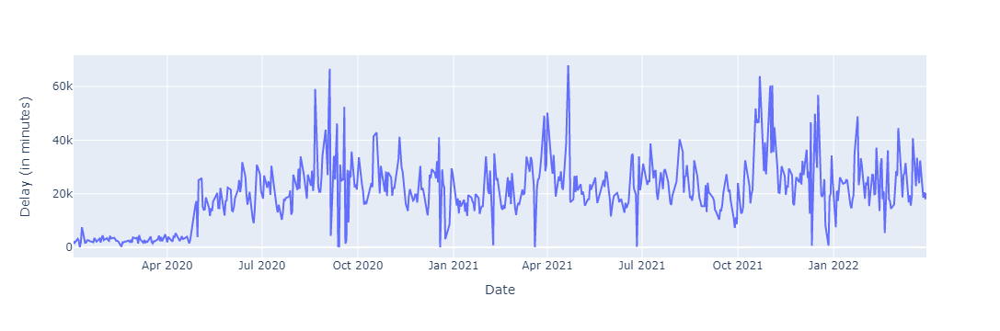

In [16]:
fig = px.line(data2020_2022_groupbyDate, x='Date', y= 'Delay', labels={'Delay': 'Delay (in minutes)'})
#fig2 = px.scatter(x=['2022-03-17', '2022-03-27'], y=[max(data2020_2022_groupbyDate['Delay']), min(data2020_2022_groupbyDate['Delay'])],
 #                size=[120,100])
#fig.add_trace(fig2.data[0])
fig.show()

The above Line graph tells us that there are lots of delay. But, does not tell us which days have more delays! 


## Trend of DELAY for days of week

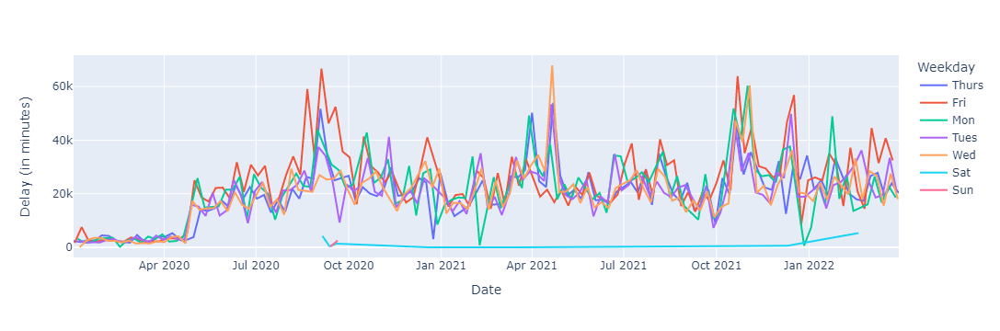

In [17]:
fig = px.line(data2020_2022_groupbyDate, x='Date', y= 'Delay', color='Weekday' ,
              labels={'Delay': 'Delay (in minutes)'})
fig.show()
fig.write_image("Figures/LineplotWeekdayFC20202022.png")

No day is significantly better than the other! 

## Trend of DELAY for time of day


Lets split days into Morning, Afternoon & Evening 

In [18]:
data2020_2022

,Transponder,LocationIn,LocationOut,TimeIn,TimeOut,Delay,Date,Weekday,Month,Hours
0,17022,2(A),2(En),2020-01-02 08:56:49,2020-01-02 10:51:46,0,2020-01-02,Thurs,January,08:00-08:59
1,8230,2(A),2(En),2020-01-02 10:17:40,2020-01-02 11:01:05,1,2020-01-02,Thurs,January,10:00-10:59
2,8212,2(A),2(En),2020-01-02 09:17:53,2020-01-02 11:22:03,22,2020-01-02,Thurs,January,09:00-09:59
3,8248,2(A),2(En),2020-01-02 10:38:28,2020-01-02 11:22:14,22,2020-01-02,Thurs,January,10:00-10:59
4,8433,2(A),2(En),2020-01-02 09:47:12,2020-01-02 11:22:42,23,2020-01-02,Thurs,January,09:00-09:59
...,...,...,...,...,...,...,...,...,...,...
275100,58660,2(En),2(Ex),2022-03-31 19:12:26,2022-03-31 19:36:49,24,2022-03-31,Thurs,March,19:00-20:00
275101,58660,2(A),2(Ex),2022-03-31 19:03:53,2022-03-31 19:36:49,33,2022-03-31,Thurs,March,19:00-20:00
275102,8160,2(A),2(Ex),2022-03-31 19:08:27,2022-03-31 19:38:26,30,2022-03-31,Thurs,March,19:00-20:00
275103,8456,2(En),2(Ex),2022-03-31 19:27:31,2022-03-31 19:43:26,16,2022-03-31,Thurs,March,19:00-20:00


In [19]:
# hour category


In [20]:
timeofday = ['Morning','Early-afternoon','Late-afternoon','Evening']
TimeOfDayColumn = []
for i in data2020_2022['TimeIn']:
    if (i.time() > datetime.time(6, 0, 0) and i.time() < datetime.time(12, 0, 0) ):
        TimeOfDayColumn.append('Morning') 
    elif(i.time() >= datetime.time(12, 0, 0) and i.time() < datetime.time(15, 0, 0) ):
        TimeOfDayColumn.append('Early-afternoon')
    elif(i.time() >= datetime.time(15, 0, 0) and i.time() < datetime.time(18, 0, 0) ):
        TimeOfDayColumn.append('Late-afternoon')
    else:
        TimeOfDayColumn.append('Evening')
data2020_2022['Time Of Day'] = TimeOfDayColumn


In [21]:
data2020_2022_groupbyDate = data2020_2022.groupby(['Date','Month','Weekday']).sum().reset_index()
data2020_2022_groupbyDate
# this Delay is delay of all truck in certain date 



,Date,Month,Weekday,Transponder,Delay
0,2020-01-02,January,Thurs,2766061,2372
1,2020-01-03,January,Fri,2522163,1640
2,2020-01-06,January,Mon,2750628,3192
3,2020-01-07,January,Tues,3045710,2447
4,2020-01-08,January,Wed,16510,28
...,...,...,...,...,...
572,2022-03-25,March,Fri,14581172,32413
573,2022-03-28,March,Mon,12598617,18573
574,2022-03-29,March,Tues,10960035,20530
575,2022-03-30,March,Wed,10496428,18014


In [22]:
data2020_2022_groupbyTimeofDay = data2020_2022.groupby(['Date','Month','Time Of Day']).sum().reset_index()
data2020_2022_groupbyTimeofDay
# this Delay is delay of all truck in certain date 

,Date,Month,Time Of Day,Transponder,Delay
0,2020-01-02,January,Early-afternoon,763602,614
1,2020-01-02,January,Evening,659950,293
2,2020-01-02,January,Late-afternoon,937163,612
3,2020-01-02,January,Morning,405346,853
4,2020-01-03,January,Early-afternoon,954524,647
...,...,...,...,...,...
2265,2022-03-30,March,Morning,2429657,4225
2266,2022-03-31,March,Early-afternoon,5101908,8798
2267,2022-03-31,March,Evening,1558190,2038
2268,2022-03-31,March,Late-afternoon,2710570,5896


In [23]:
data2020_2022_groupbyHours = data2020_2022.groupby(['Date','Month','Hours']).sum().reset_index()
data2020_2022_groupbyHours
# this Delay is delay of all truck in certain date 

,Date,Month,Hours,Transponder,Delay
0,2020-01-02,January,08:00-08:59,17022,0
1,2020-01-02,January,09:00-09:59,24863,71
2,2020-01-02,January,10:00-10:59,103370,222
3,2020-01-02,January,11:00-11:59,260091,560
4,2020-01-02,January,12:00-12:59,162570,266
...,...,...,...,...,...
6264,2022-03-31,March,15:00-15:59,513658,2219
6265,2022-03-31,March,16:00-16:59,1188998,2020
6266,2022-03-31,March,17:00-17:59,1007914,1657
6267,2022-03-31,March,18:00-18:59,1210043,1801


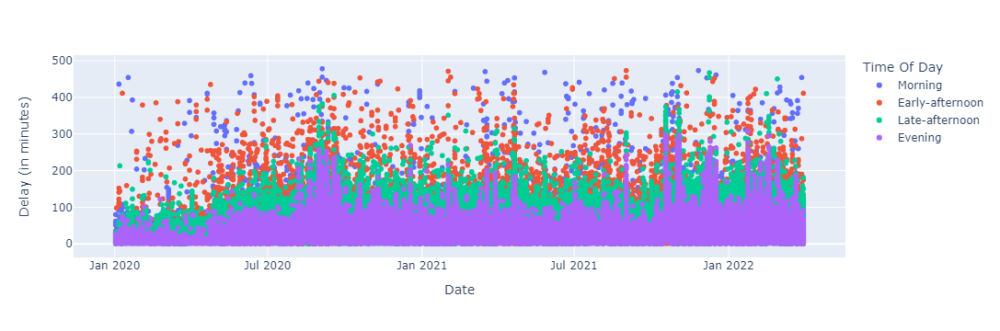

In [24]:
fig = px.scatter(data2020_2022, x='Date', y= 'Delay', color='Time Of Day' ,
              labels={'Delay': 'Delay (in minutes)'})
fig.show()

Most of the truck leave quite quickly in the morning ++ ?? 


In [25]:
# Number of trucks in the morning vs evening


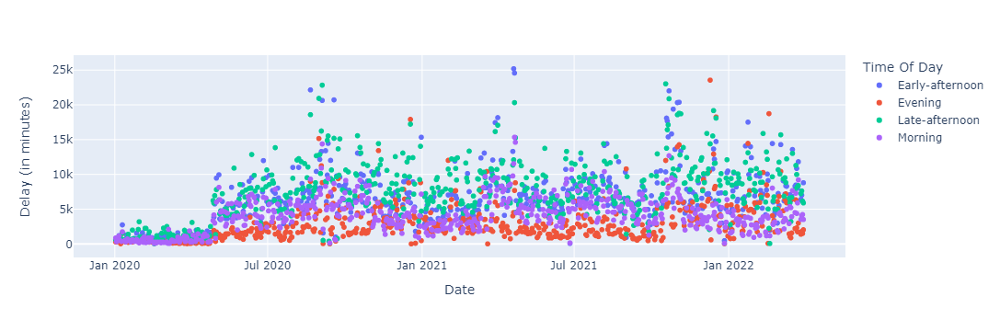

In [26]:

fig = px.scatter(data2020_2022_groupbyTimeofDay, x='Date', y= 'Delay', color='Time Of Day' ,
              labels={'Delay': 'Delay (in minutes)'})
fig.show()

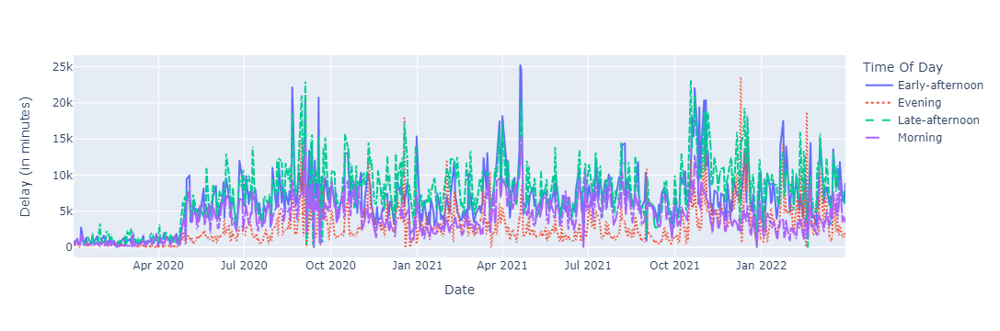

In [27]:

fig = px.line(data2020_2022_groupbyTimeofDay, x='Date', y= 'Delay', color='Time Of Day' ,
              labels={'Delay': 'Delay (in minutes)'}, line_dash='Time Of Day')
fig.show()
fig.write_image("Figures/LineplotTimeofDayFC20202022.png")

In recent weeks, we have more delays in the evening. So, we should reschudle our evening trucks on other time (maybe extending current opening hour of terminal gates, which is 16:30 as per last week). After all, leaving of trucks during high-peak office hour & pedestrian walk in this summer time is NOT impressive.  

In [28]:
#pip install chart-studio

### Bubble Plot

In [29]:
data2020_2022_groupbyTimeofDayBubblePlot = data2020_2022.groupby(['Date','Month','Time Of Day', 'Weekday', 'LocationIn']).sum().reset_index()
data2020_2022_groupbyTimeofDayBubblePlot

,Date,Month,Time Of Day,Weekday,LocationIn,Transponder,Delay
0,2020-01-02,January,Early-afternoon,Thurs,2(A),763602,614
1,2020-01-02,January,Evening,Thurs,2(A),659950,293
2,2020-01-02,January,Late-afternoon,Thurs,2(A),937163,612
3,2020-01-02,January,Morning,Thurs,2(A),405346,853
4,2020-01-03,January,Early-afternoon,Fri,2(A),954524,647
...,...,...,...,...,...,...,...
4201,2022-03-31,March,Evening,Thurs,2(En),553579,881
4202,2022-03-31,March,Late-afternoon,Thurs,2(A),1589169,3872
4203,2022-03-31,March,Late-afternoon,Thurs,2(En),1121401,2024
4204,2022-03-31,March,Morning,Thurs,2(A),1092374,1760


In [30]:
data2020_2022_groupbyTimeofDayBubblePlot.columns

Index(['Date', 'Month', 'Time Of Day', 'Weekday', 'LocationIn', 'Transponder',
       'Delay'],
      dtype='object')

In [31]:
data2020_2022_groupbyTimeofDayBubblePlot.Transponder.unique()
data2020_2022_groupbyTimeofDayBubblePlot.nunique()

Date            577
Month            12
Time Of Day       4
Weekday           7
LocationIn        2
Transponder    4200
Delay          2967
dtype: int64

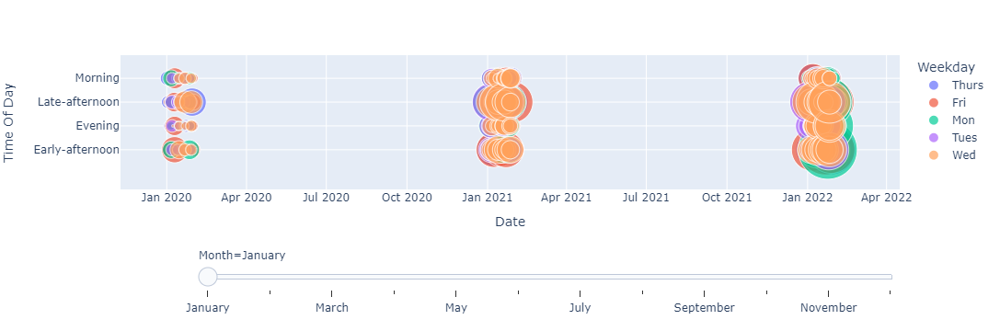

<Figure size 2400x1800 with 0 Axes>

In [32]:

figure(figsize=(8, 6), dpi=300)
fig = px.scatter(data2020_2022_groupbyTimeofDayBubblePlot, x="Date", y="Time Of Day", animation_frame="Month", # animation_group="LocationIn",hover_name="LocationIn" ,
           size="Delay", color="Weekday",
           size_max=55) # , range_x=[     100,100000], range_y=[25,90], 

fig["layout"].pop("updatemenus") # optional, drop animation buttons
fig.show()
fig.write_image("Figures/BubbleplotTimeofDayFC20202022.png")

Delay is not dependent on day of week (linegraph), but depends on time of day, more in afternoon.

Now one can argue how I categohour into time of day? Show hourly delay for same dataset.. is the trend similar? Lets find out in the "Trend of Delay by Hours" section

## Trend of DELAY by Hours

In [33]:
data2020_2022_groupbyHours = data2020_2022.groupby(['Date','Month','Time Of Day', 'Weekday', 'LocationIn', 'Hours']).sum().reset_index()
data2020_2022_groupbyHours

,Date,Month,Time Of Day,Weekday,LocationIn,Hours,Transponder,Delay
0,2020-01-02,January,Early-afternoon,Thurs,2(A),12:00-12:59,162570,266
1,2020-01-02,January,Early-afternoon,Thurs,2(A),13:00-13:59,306845,182
2,2020-01-02,January,Early-afternoon,Thurs,2(A),14:00-14:59,294187,166
3,2020-01-02,January,Evening,Thurs,2(A),18:00-18:59,331416,180
4,2020-01-02,January,Evening,Thurs,2(A),19:00-20:00,328534,113
...,...,...,...,...,...,...,...,...
11094,2022-03-31,March,Morning,Thurs,2(A),10:00-10:59,453766,542
11095,2022-03-31,March,Morning,Thurs,2(A),11:00-11:59,441820,628
11096,2022-03-31,March,Morning,Thurs,2(En),09:00-09:59,67982,258
11097,2022-03-31,March,Morning,Thurs,2(En),10:00-10:59,270391,881


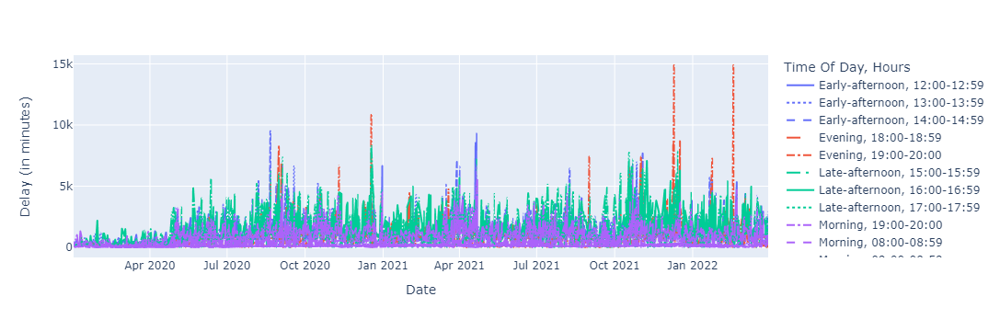

In [34]:
fig = px.line(data2020_2022_groupbyHours, x='Date', y= 'Delay', color='Time Of Day' , #range_color= [5,8],
              labels={'Delay': 'Delay (in minutes)'}, line_dash='Hours')
fig.show()
fig.write_image("Figures/LineJanMarFC20202022.png")

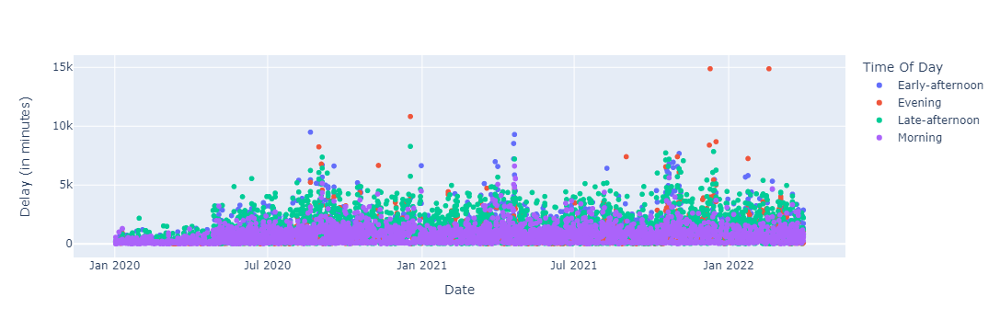

In [35]:
fig = px.scatter(data2020_2022_groupbyHours, x='Date', y= 'Delay', color='Time Of Day' , #range_color= [5,8],
              labels={'Delay': 'Delay (in minutes)'})
fig.show()
fig.write_image("Figures/scatterplotTimeofDayFC20202022.png")

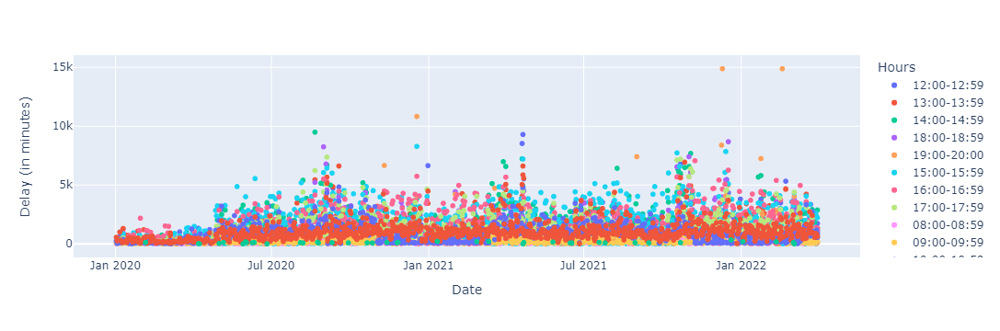

In [36]:
fig = px.scatter(data2020_2022_groupbyHours, x='Date', y= 'Delay', color='Hours' , #range_color= [5,8],
              labels={'Delay': 'Delay (in minutes)'}) #, legend={'traceorder':'normal'}
fig.show() 
# ++ change color pallete & transparency alpha 

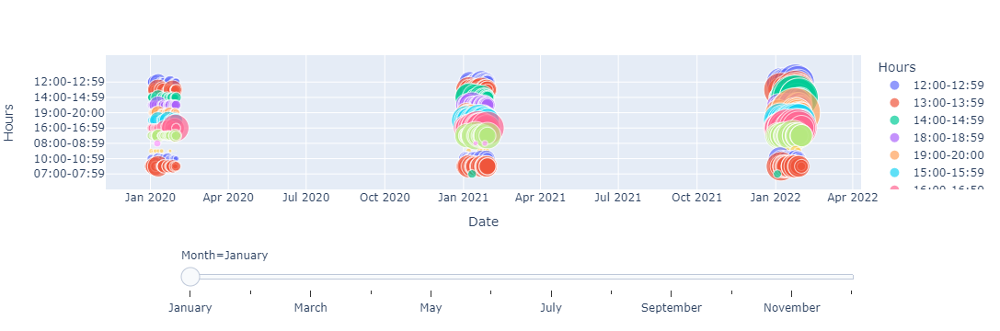

<Figure size 2400x1800 with 0 Axes>

In [37]:
figure(figsize=(8, 6), dpi=300)
fig = px.scatter(data2020_2022_groupbyHours, x="Date", y="Hours", animation_frame="Month",  # animation_group="LocationIn",hover_name="LocationIn" ,
           size="Delay", color="Hours",
           size_max=55) # , range_x=[     100,100000], range_y=[25,90], 

fig["layout"].pop("updatemenus") # optional, drop animation buttons
fig.show()

In [ ]:
#fig=plt.figure(figsize=(12,12), dpi= 100, facecolor='w', edgecolor='k')
fig = px.scatter(data2020_2022_groupbyHours, x="Date", y="Hours", animation_frame="Month",  # animation_group="LocationIn",hover_name="LocationIn" ,
           size="Delay", color="Hours",
           size_max=55) # , range_x=[     100,100000], range_y=[25,90], 

fig["layout"].pop("updatemenus") # optional, drop animation buttons

fig.update_yaxes(categoryorder="category ascending")
fig.show()

fig.write_image("Figures/BubbleplotHourFC20202022.png")

In [ ]:
#fig=plt.figure(figsize=(12,12), dpi= 100, facecolor='w', edgecolor='k')
fig = px.scatter(data2020_2022_groupbyHours, x="Date", y="Hours", animation_frame="Month",  # animation_group="LocationIn",hover_name="LocationIn" ,
           color="Delay"
           ) # , range_x=[     100,100000], range_y=[25,90], 

fig["layout"].pop("updatemenus") # optional, drop animation buttons

fig.update_yaxes(categoryorder="category ascending")
fig.show()

fig.write_image("Figures/scatterplotHourFC20202022.png")

In [40]:
#pip install -U kaleido

## Exploring delay of certain truck using certain gate

In [41]:
# Lets read data for Transponder 17107

mask = data2020_2022['Transponder']==17107 
data_T17107 = data2020_2022[mask]


Transponder 8156 & LocationIn = 2(En)

In [42]:
data_T17107

,Transponder,LocationIn,LocationOut,TimeIn,TimeOut,Delay,Date,Weekday,Month,Hours,Time Of Day
14308,17107,2(A),2(En),2020-04-27 08:23:16,2020-04-27 10:08:23,8,2020-04-27,Mon,April,08:00-08:59,Morning
14687,17107,2(A),2(En),2020-04-27 18:24:20,2020-04-27 18:26:32,2,2020-04-27,Mon,April,18:00-18:59,Evening
14692,17107,2(En),2(Ex),2020-04-27 18:26:32,2020-04-27 18:31:23,5,2020-04-27,Mon,April,18:00-18:59,Evening
14693,17107,2(A),2(Ex),2020-04-27 18:24:20,2020-04-27 18:31:23,7,2020-04-27,Mon,April,18:00-18:59,Evening
17645,17107,2(A),2(En),2020-05-05 14:30:03,2020-05-05 14:33:21,3,2020-05-05,Tues,May,14:00-14:59,Early-afternoon
17660,17107,2(En),2(Ex),2020-05-05 14:33:21,2020-05-05 14:53:07,20,2020-05-05,Tues,May,14:00-14:59,Early-afternoon
17661,17107,2(A),2(Ex),2020-05-05 14:30:03,2020-05-05 14:53:07,23,2020-05-05,Tues,May,14:00-14:59,Early-afternoon
17792,17107,2(A),2(En),2020-05-05 17:40:40,2020-05-05 17:42:00,1,2020-05-05,Tues,May,17:00-17:59,Late-afternoon
17819,17107,2(En),2(Ex),2020-05-05 17:42:00,2020-05-05 18:07:36,26,2020-05-05,Tues,May,17:00-17:59,Late-afternoon
17820,17107,2(A),2(Ex),2020-05-05 17:40:40,2020-05-05 18:07:36,27,2020-05-05,Tues,May,17:00-17:59,Late-afternoon


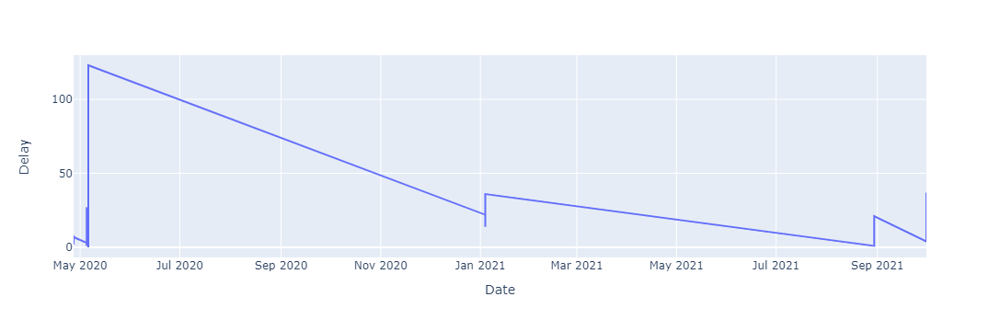

In [43]:
fig = px.line(data_T17107, x='Date', y= 'Delay')
fig.show() 

# Remarks